<img style="width:40%;float:right" src="https://upload.wikimedia.org/wikipedia/it/thumb/4/47/Logo_PoliTo_dal_2021_blu.png/2880px-Logo_PoliTo_dal_2021_blu.png"/>

# Mathematics in Machine Learning
## Online Shoppers Purchasing Intention Dataset
### Hadi Nejabat s246601

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
# from IPython.core.display import HTML
import plotly
import plotly.express as px
from plotly import graph_objects as go
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
from plotly.offline import plot as plot
plotly.offline.init_notebook_mode()
pd.options.plotting.backend = "plotly"

from sklearn.pipeline import Pipeline 
from imblearn.pipeline import Pipeline as ImbalancedPipeline
from imblearn import FunctionSampler

from sklearn.neighbors import LocalOutlierFactor as LOF
from sklearn.ensemble import IsolationForest
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import NearMiss
from sklearn.model_selection import train_test_split as tts
from sklearn.model_selection import GridSearchCV

from sklearn.neighbors import KNeighborsClassifier
from sklearn.kernel_approximation import Nystroem
from sklearn.svm import LinearSVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.neural_network import MLPClassifier

from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve
from sklearn.metrics import f1_score, confusion_matrix

import warnings
warnings.filterwarnings('ignore')

# 1. Dataset description
## 1.1 Introduction
MAGIC (**Major Atmospheric Gamma Imaging Cherenkov** Telescopes) is a system of two Imaging Atmospheric Cherenkov telescopes situated in the Canary Islands, at the Roque de los Muchachos Observatory on La Palma. MAGIC detects particle showers released by gamma rays, using the Cherenkov radiation: a faint light radiated by the charged particles in the showers. 
<!-- Cherenkov gamma telescope observes high energy gamma rays, taking advantage of the radiation emitted by charged particles produced inside the electromagnetic showers initiated by the gammas, and developing in the atmosphere. -->
The first telescope was built in 2004 and operated for five years in standalone mode. A second MAGIC telescope (MAGIC-II), at a distance of 85 m from the first one, became operative in 2009. Together they integrate the MAGIC telescope stereoscopic system.
MAGIC is sensitive to cosmic gamma rays with photon energies between 50 GeV (later lowered to 25 GeV) and 30 TeV due to its large mirror.


## 1.2 The dataset
The dataset is generated by means of a Monte Carlo program, **CORSIKA**, to simulate registrations of high energy gamma particles. The Cherenkov radiation (of visible to UV wavelengths) leaks through the atmosphere and gets recorded in the detector, allowing reconstruction of the shower parameters. The available information consists of pulses left by the incoming Cherenkov photons on the photomultiplier tubes, arranged in a plane: the camera. Depending on the energy of the primary gamma, a total of few hundreds to some 10000 Cherenkov photons get collected, in patterns (called the shower image), allowing to discriminate statistically those caused by primary gammas (**signal**) from the images of hadronic showers initiated by cosmic rays in the upper atmosphere (**background**). 

Typically, the image of a shower after some pre-processing is an elongated cluster. Its long axis is oriented towards the camera center if the shower axis is parallel to the telescope's optical axis, i.e. if the telescope axis is directed towards a point source. A principal component analysis is performed in the camera plane, which results in a correlation axis and defines an ellipse. The characteristic parameters of this ellipse (often called \textbf{Hillas parameters}) are among the image parameters that can be used for discrimination. The energy depositions are typically asymmetric along the major axis, and this asymmetry can also be used in discrimination. Other discriminating characteristics include the extent of the cluster in the image plane, or the total sum of depositions. 

## 1.3 Objective
The goal of this project is to study how different Machine Learning techniques perform in discriminating between signal (gamma-ray showers) and background (hadron shower) events.
The simple classification accuracy is not particularly meaningful in this scenario since classifying a background event as signal is considered worse than classifying a signal event as background, thus we need to carefully consider the type of errors a model makes in the evaluation phase.

In [2]:
class Dataset():
    def __init__(self, path):
        self.read_data(path, 'class')

    def read_data(self, path, label, delimiter=","):
        self.df = pd.read_csv(path, delimiter=delimiter)
        self.df.style
        self.X = self.df.drop(label, axis = 1)
        self.y = self.df[label].copy()
        self.classes = list(self.df.value_counts(label).index)[::-1]

        for index,c in enumerate(self.classes):
            self.y.replace(c, index, inplace=True)

    def drop(self, feature):
        self.df.drop(feature, inplace=True, axis=1)    

    def train(self, param_grid, test_size=0.2, outlier=None, scale=False, pca=0, rebalancing=None, clf=None):
        if clf is not None:
            self.X_train, self.X_test, self.y_train, self.y_test = tts(self.X, self.y, test_size=test_size, shuffle=True, stratify=self.y)

            steps = []
            if outlier is not None and outlier == 'iforest':
                steps.append(("outlier", FunctionSampler(func=self.isolation_forest)))
            elif outlier is not None and outlier == 'lof':
                steps.append(("outlier", FunctionSampler(func=self.lof)))
            if scale:
                steps.append(("scaler", StandardScaler()))
            if pca > 0:
                steps.append(("pca", PCA(n_components = pca, svd_solver='full')))
            if rebalancing is not None:
                if rebalancing == 'over':
                    steps.append(("smote", SMOTE(n_jobs=-1)))
                elif rebalancing == 'under':
                    steps.append(("nearmiss", NearMiss(version=3)))
            if clf == 'svc':
                steps.append(('nystroem', Nystroem(n_jobs=-1)))
                steps.append(('classifier', LinearSVC()))
            elif clf == 'knn':
                steps.append(('classifier', KNeighborsClassifier()))
            elif clf == 'random_forest':
                steps.append(('classifier', RandomForestClassifier()))

            self.pipeline = ImbalancedPipeline(steps)

            self.gridsearch = GridSearchCV(self.pipeline, param_grid, scoring='f1', n_jobs=-1)
            self.gridsearch.fit(self.X_train, self.y_train)
        else:
            print("Select valid classifier")

    def predict(self):
        print("Predicting..")
        self.best_estimator = self.gridsearch.best_estimator_
        self.y_pred = self.best_estimator.predict(self.X_test)
        f1 = f1_score(self.y_test, self.y_pred)
        print(f"Best model with parameters: {self.gridsearch.best_params_}\nF1-score: {f1}")
        return f1

    def isolation_forest(self, X, y, n_estimators=100):
        X = np.asarray(X)
        y = np.asarray(y)

        outliers = IsolationForest(n_estimators = n_estimators, n_jobs = -1).fit_predict(X)
        X = X[outliers == 1, :]
        y = y[outliers == 1]

        return (X, y)

    def lof(self, X, y, n_neighbors = 20):
        X = np.asarray(X)
        y = np.asarray(y)

        outliers = LOF(n_neighbors = n_neighbors, n_jobs = -1).fit_predict(X)
        X = X[outliers == 1, :]
        y = y[outliers == 1]

        return (X, y)

    def describe_dataset(self):
        print("Feature Types:")
        print(self.df.dtypes)
        return self.df

    def feature_statistics(self):
        return self.df.describe()

    def detect_outliers(self, method=None, n=None):
        if method not in ['lof', 'iforest']:
            print("Select different method")
        else:
            if method == 'lof':
                outliers = LOF(n_neighbors=n, n_jobs=-1).fit_predict(self.X)
            elif method == 'iforest':
                outliers = IsolationForest(n_estimators=n ,n_jobs=-1).fit_predict(self.X)

            print(f'{method}: {np.count_nonzero(outliers == -1)} outliers found')

    def plot_confusion_matrix(self):
        conf_matrix = confusion_matrix(self.y_test, self.y_pred)
        color = [[0.0, '#91001b'], [0.5, '#f2f2f2'], [1.0, '#274a69']]
        fig_conf_matrix =  ff.create_annotated_heatmap(z=corr.to_numpy().round(decimals=2), x=corr.columns.tolist(), y=corr.columns.tolist(), colorscale=color, xgap=2, ygap=2, showscale=True, font_colors=["#FFFFFF","#000000"])
        fig_conf_matrix.update_layout(go.Layout(title_text="Feature Correlation Matrix", width=800, height=800, xaxis_showgrid=False,yaxis_showgrid=False,yaxis_autorange='reversed'))
    #         plot(fig_conf_matrix, filename = 'conf_matrix.html')
    #         display(HTML('conf_matrix.html'))
        fig_conf_matrix.show()

    def plot_class_distribution(self):
        fig_class_dist = go.Figure([go.Bar(x=self.classes, y=self.y.value_counts(), marker_color=["#91001b", "#274a69"])])
        fig_class_dist.update_layout(title_text="Samples per class", showlegend=False)
    #         plot(fig_class_dist, filename = 'class_distribution.html')
    #         display(HTML('class_distribution.html'))
        fig_class_dist.show()

    def corr_matrix(self):
        corr = self.X.corr()
        color = [[0.0, '#91001b'], [0.5, '#f2f2f2'], [1.0, '#274a69']]
        fig_corr_heatmap = ff.create_annotated_heatmap(z=corr.to_numpy().round(decimals=2), x=corr.columns.tolist(), y=corr.columns.tolist(), colorscale=color, xgap=2, ygap=2, showscale=True, font_colors=["#FFFFFF","#000000"])
        fig_corr_heatmap.update_layout(go.Layout(title_text="Feature Correlation Matrix", width=800, height=800, xaxis_showgrid=False,yaxis_showgrid=False,yaxis_autorange='reversed'))
    #         plot(corr_heatmap, filename = 'corr_matrix.html')
    #         display(HTML('corr_matrix.html'))
        fig_corr_heatmap.show()

    def pair_plot(self):
        distr_data = self.df.copy()
        distr_palette = sns.color_palette(["#91001b", "#274a69"])
        pplot = sns.pairplot(distr_data, hue='class', palette=distr_palette)
        plt.show(pplot)

    def boxplot(self):
        fig_total = go.Figure()
        for feature in self.df:
            fig_total.add_trace(go.Box(y=self.df[feature], name=feature))

        fig_total.update_layout(
            xaxis_title='features',
        )
    #         plot(fig_total, filename = 'boxplot.html')
    #         display(HTML('boxplot.html'))
        fig_total.show()

        fig_features = make_subplots(rows=2, cols=5, subplot_titles = self.df.keys())
        for i, feature in enumerate(self.df):
            if feature != 'class':
                fig_features.add_trace(go.Box(y=self.df[feature], x=self.df['class'], boxmean='sd', name=feature), row=1 if i <5 else 2, col = i%5 +1)
        fig_features.update_layout(title_text="Feature distribution per class", showlegend=False)
        fig_features.update_yaxes(automargin=True)
    #         plot(fig_features, filename = 'boxplot_pairs.html')
    #         display(HTML('boxplot_pairs.html'))
        fig_features.show()

    def plot_pca(self):
        X_pca = PCA(n_components = 3).fit_transform(StandardScaler().fit_transform(self.df.drop('class', axis=1)))
        df_pca = pd.DataFrame(X_pca, columns = ['PC-1', 'PC-2', 'PC-3'])
        df_pca['label'] = list(self.df['class'].replace({"g":1, "h":0}))

        df_pca_g = df_pca[:][df_pca['label'] == 1]
        df_pca_h = df_pca[:][df_pca['label'] == 0]

        fig_pca = go.Figure(data=[go.Scatter3d(
                x=df_pca_g['PC-1'],
                y=df_pca_g['PC-2'],
                z=df_pca_g['PC-3'],
                mode='markers',
                name='g',
                marker=dict(
                    size=3,
                    color="#91001b",
                    opacity=1
                )
            ), 
             go.Scatter3d(
                x=df_pca_h['PC-1'],
                y=df_pca_h['PC-2'],
                z=df_pca_h['PC-3'],
                mode='markers',
                name='h',
                marker=dict(
                    size=3,
                    color="#274a69",
                    opacity=1
                )
            )])
        fig_pca.update_layout(height=1000, title_text="Principal Component Analysis, first three components", showlegend=True)
    #         plot(fig_pca, filename = 'PCA.html')
    #         display(HTML('PCA.html'))
        fig_pca.show()

    def plot_explained_variance(self, n_components):
        pca = PCA(n_components = n_components)
        pca.fit(StandardScaler().fit_transform(self.df.drop('class', axis=1)))

        evr = pca.explained_variance_ratio_
        cum_var = np.cumsum(evr)

        fig_variance = go.Figure()

        fig_variance.add_trace(go.Bar(x=[f"PC-{i}" for i in range(1, len(evr)+1)], y=evr, marker_color="#91001b", name="Explained variance ratio"))
        fig_variance.add_trace(go.Scatter(x=[f"PC-{i}" for i in range(1, len(evr)+1)], y=cum_var, mode='lines+markers', marker_color="#274a69", name="Cumulative variance"))

        fig_variance.update_layout(title_text="Principal Component Analysis, explained variance", showlegend=True)
        fig_variance.show()

# 2. Dataset exploration
As previously stated, after some pre-processing the image of a shower is an elongated cluster, having an elliptical shape. The characteristic parameters of this ellipse (Hillas parameters) comprise the raw data of our dataset. In total we have 10 attributes describing the event.

In [31]:
dataset = pd.read_csv("online_shoppers_intention.csv")
y = dataset['Revenue']
# print(y.size)
X = dataset.iloc[:, :-1]
# print(X.shape)
dataset.info()
# print(dataset)

"""
feature_values = list(dataset.value_counts('Revenue').index)[::-1]

# print(feature_value)

for index, c in enumerate(feature_values):
    # print(index, c)
    y.replace(c, index, inplace=True)
"""


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12330 entries, 0 to 12329
Data columns (total 18 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Administrative           12330 non-null  int64  
 1   Administrative_Duration  12330 non-null  float64
 2   Informational            12330 non-null  int64  
 3   Informational_Duration   12330 non-null  float64
 4   ProductRelated           12330 non-null  int64  
 5   ProductRelated_Duration  12330 non-null  float64
 6   BounceRates              12330 non-null  float64
 7   ExitRates                12330 non-null  float64
 8   PageValues               12330 non-null  float64
 9   SpecialDay               12330 non-null  float64
 10  Month                    12330 non-null  object 
 11  OperatingSystems         12330 non-null  int64  
 12  Browser                  12330 non-null  int64  
 13  Region                   12330 non-null  int64  
 14  TrafficType           

"\nfeature_values = list(dataset.value_counts('Revenue').index)[::-1]\n\n# print(feature_value)\n\nfor index, c in enumerate(feature_values):\n    # print(index, c)\n    y.replace(c, index, inplace=True)\n"

In [4]:
!pip3 install --upgrade nbformat


In [35]:
print(y.value_counts())
fig_class_dist = go.Figure([go.Bar(x=list(dataset.value_counts('Revenue').index)[::-1], 
                            y=y.value_counts(), 
                            marker_color=["#008B8B", "#DC143C"])])
fig_class_dist.update_layout(title_text="Samples per Revenue", showlegend=False)
fig_class_dist.show()

False    10422
True      1908
Name: Revenue, dtype: int64


Given the imbalance in the class distributions we will consider some rebalancing strategies, in particular **SMOTE for oversampling** and **Near Miss for undersampling**, which can be a viable option since our dataset is quite large in size.

## 2.2 Feature analysis
From a numerical analysis of the feature, we can see that they seem to have very different distributions, which we can more easily confirm by looking at a graphical representation of such distributions:

In [36]:
dataset.describe()

,Administrative,Administrative_Duration,Informational,Informational_Duration,ProductRelated,ProductRelated_Duration,BounceRates,ExitRates,PageValues,SpecialDay,OperatingSystems,Browser,Region,TrafficType
count,12330.000000,12330.000000,12330.000000,12330.000000,12330.000000,12330.000000,12330.000000,12330.000000,12330.000000,12330.000000,12330.000000,12330.000000,12330.000000,12330.000000
mean,2.315166,80.818611,0.503569,34.472398,31.731468,1194.746220,0.022191,0.043073,5.889258,0.061427,2.124006,2.357097,3.147364,4.069586
std,3.321784,176.779107,1.270156,140.749294,44.475503,1913.669288,0.048488,0.048597,18.568437,0.198917,0.911325,1.717277,2.401591,4.025169
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000
25%,0.000000,0.000000,0.000000,0.000000,7.000000,184.137500,0.000000,0.014286,0.000000,0.000000,2.000000,2.000000,1.000000,2.000000
50%,1.000000,7.500000,0.000000,0.000000,18.000000,598.936905,0.003112,0.025156,0.000000,0.000000,2.000000,2.000000,3.000000,2.000000
75%,4.000000,93.256250,0.000000,0.000000,38.000000,1464.157214,0.016813,0.050000,0.000000,0.000000,3.000000,2.000000,4.000000,4.000000
max,27.000000,3398.750000,24.000000,2549.375000,705.000000,63973.522230,0.200000,0.200000,361.763742,1.000000,8.000000,13.000000,9.000000,20.000000


In [37]:
fig_total = go.Figure()
for feature in dataset:
    fig_total.add_trace(go.Box(y=dataset[feature], name=feature))

fig_total.update_layout(
    xaxis_title='features',
)
fig_total.show()

fig_features = make_subplots(rows=2, cols=5, subplot_titles = dataset.keys())
for i, feature in enumerate(dataset):
    if feature != 'class':
        fig_features.add_trace(go.Box(y=dataset[feature], x=dataset['Revenue'], boxmean='sd', name=feature), row=1 if i <5 else 2, col = i%5 +1)
fig_features.update_layout(title_text="Feature distribution per class", showlegend=False)
fig_features.update_yaxes(automargin=True)
fig_features.show()

From a first visual analysis, we can see that many features are distributed relatively evenly between the two classes, **g** and **h**, suggesting that some form of dimensionality reduction may be helpful in reducing the size of our data to allow for a reduction in training times when analyzing different models.

### 2.2.1 Feature Correlation
Another important step in analyzing our dataset is the feature correlation analysis, which we are going to approach by studying the **Pearson correlation coefficient** between each pair of variables.
The Pearson correlation coefficient between two random variables $(X, Y)$ is defined as:

$ \rho_{X, Y}= \frac{\mathrm{cov} (X, Y)}{\sigma_X\sigma_Y} $

where $ \mathrm{cov}(X, Y) = \mathrm{E}[(X - \mu_X)(Y - \mu_Y)] $ is the covariance between $X$ and $Y$, $\mu_{X,Y}$ indicate the mean of $X$ and $Y$ and $\sigma_{X,Y}$ represent the standard deviation of $X$ and $Y$.

This coefficient takes values between -1 and 1:
*  a value of 1 implies that a linear equation describes the relationship between $X$ and $Y$ perfectly, with all data points lying on a line for which Y increases as X increases. 
*  a value of −1 implies that all data points lie on a line for which $Y$ decreases as $X$ increases. 
*  a value of 0 implies that there is no linear correlation between the variables $X$ and $Y$.

It is clear that high values (in absolute value) of the correlation coefficient indicate data redundancy: the two features carry very similar information, which means that dropping one of the two could lighten our footprint without incurring in loss of important information.

By plotting a feature correlation matrix we can see at a glance all the different correlation coefficients:

In [59]:
corr = X.corr()

color = [[0.0, '#DC143C'], [0.5, '#FFE4C4'], [1.0, '#1E90FF']]

fig_corr_heatmap = ff.create_annotated_heatmap(z=corr.to_numpy().round(decimals=2), x=corr.columns.tolist(), y=corr.columns.tolist(), colorscale=color, xgap=2, ygap=2, showscale=True, font_colors=["#FFFFFF","#000000"])
fig_corr_heatmap.update_layout(go.Layout(width=1000,
                                         height=1000, 
                                         xaxis_showgrid=False,
                                         yaxis_showgrid=False,
                                         yaxis_autorange='reversed'))

fig_corr_heatmap.show()


By looking at our feature correlation matrix a few correlation coefficients stand out:
*  $ \mathrm{cov}(fConc, fConc1) = 0.98 $ with *fConc* indicating the ratio between the two highest pixels over *fSize* and *fConc1* indicating the ratio between the highest pixel and *fSize*, it is quite expected that the two measure are so highly correlated
*  $ \mathrm{cov}(fConc, fsize) = -0.85 $ and $ \mathrm{cov}(fConc1, fsize) = -0.81 $ unsurprisingly indicating a very high inverse correlation between *fConc, fConc1* and *fSize*, for the reasons stated above.
*  $\mathrm{cov}(fLength, fWidth) = 0.77$ with $fLength$ indicating the major and $fWidth$ the minor axis of the Hillas ellipse are understandably quite correlated
*  $\mathrm{cov}(fLength, fSize) = 0.7$ and $\mathrm{cov}(fWidth, fSize) = 0.72$ with $fSize$ indicating the 10-log of sum of content of all pixels, is unsurprisingly quite highly correlated with $fLength$ and $fWidth$

Given the extremely high values of these correlation coefficients, it makes sense to drop some of these features in the preprocessing phase.

### 2.2.2 Pairwise relationship between features

Finally, we can inspect the degree of separability the two classes have with respect to each feature. 
By looking at the scatter plots, and keeping in mind the results we observed via the previous boxplots, we can confirm how little separability there appears to be between the two classes.
The apparent lack of separability is an issue that will need to be dealt with throughout analysis process.

Index(['Administrative', 'Administrative_Duration', 'Informational',
       'Informational_Duration', 'ProductRelated', 'ProductRelated_Duration',
       'BounceRates', 'ExitRates', 'PageValues', 'SpecialDay', 'Month',
       'OperatingSystems', 'Browser', 'Region', 'TrafficType', 'VisitorType',
       'Weekend', 'Revenue'],
      dtype='object')


ValueError: object arrays are not supported

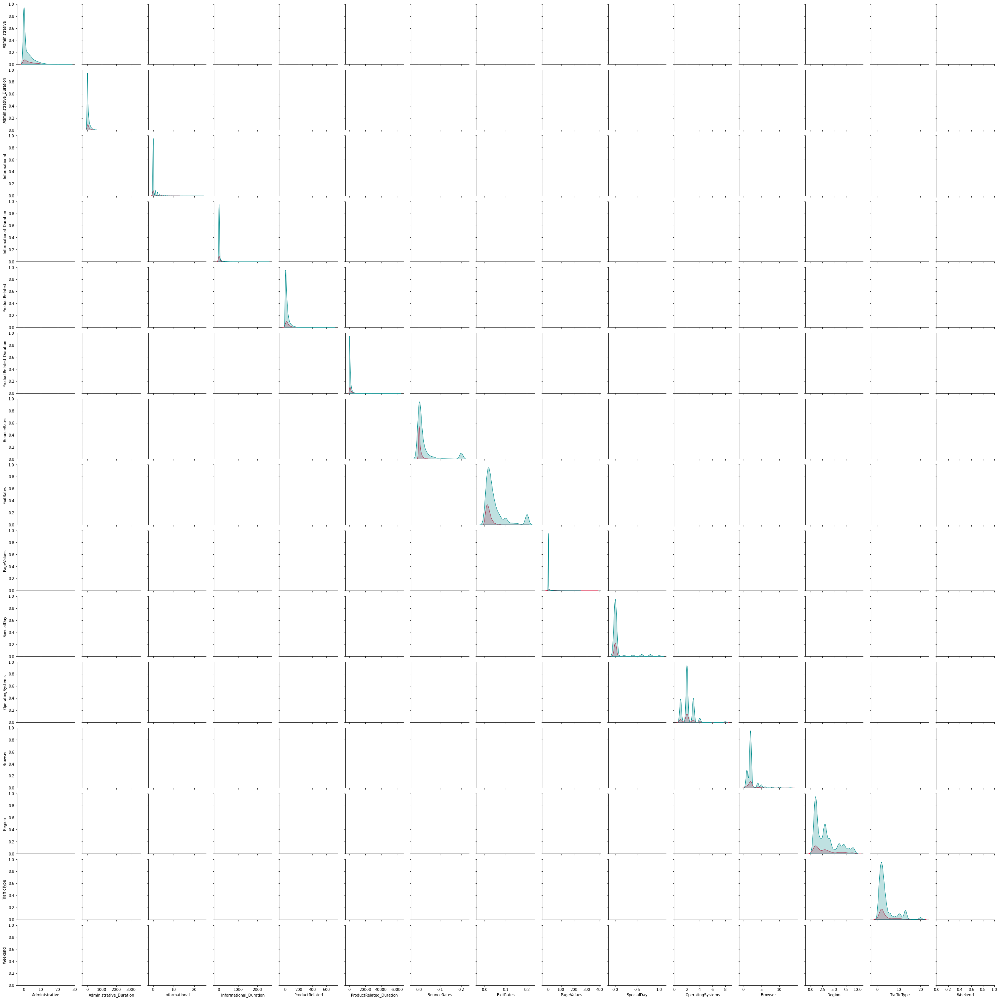

In [66]:
distr_data = dataset.copy()
print(distr_data.columns)
distr_palette = sns.color_palette(["#008B8B", "#DC143C"])
pplot = sns.pairplot(dataset, hue='Revenue', palette=distr_palette)
plt.show(pplot)


# 3. Data Pre-processing
In this section we will consider some data pre-processing techniques that will be applied to our data in different combinations, to provide us with different options and insight into how each technique affects our classification task.

## 3.1 Splitting the dataset
Since we are dealing with a single dataset, we need to divide our data into training and test before proceeding, in order to preserve a portion of our samples for testing our classification models. We will be doing this by using a stratified split, which takes into account the class imbalance when randomly selecting samples for the test set, so that class proportions are preserved. We will use 80% our our data as test (which will be later split again for cross validating our models), and the remaining 20% of the samples forms our test set.

## 3.2 Discarding highly correlated features
Given our previous analysis, we can confidently state that dropping either *fConc* or *fConc1* will result in little-to-no loss in useful information, given their almost perfect linear correlation. For this reason we proceed with dropping the *fConc* as a starting point for every dataset variation we will later consider.
We could also consider the high value of inverse correlation between *fConc, fConc1* and *fSize* as an argument for dropping other features, but given it is not as definitive as the previous case, we will go on considering other dimensionality reduction strategies for reducing the dataset footprint.

In [9]:
dataset.drop("fConc")

## 3.3 Outlier Detection
A common step in the data preprocessing pipeline is outliers detection and removal.
We identify as outliers those samples that differ significantly from other observations, usually as a result of measurement errors. 
Depending on the algorithm, the presence of a considerable amount of outliers could hurt performance: for this reason we will analyze the classification algorithms on a few versions of the dataset, with and without outlier removal to understand its impact on the different classification methods and in conjunction with other preprocessing techniques.
By representing the data with boxplots, we're able to summarise the way the data is distributed in terms of quartiles, and express outliers as samples that exceed specific thresholds based on the Interquartile Range (IQR), which is the distance between the third and first quartile. 
Since outliers should be rare occurrences, they don't fit within the IQR, and are for this reason represented as point laying outside the boxplot representation of the distribution, as we can see in the figure below.

<center>
    <figure>
        <img style="width:60%" src="https://miro.medium.com/max/18000/1*2c21SkzJMf3frPXPAR_gZA.png"/>
    </figure>
</center>

Considering the previous boxplots, there appers to be a considerable number of outliers across most of the features. 
We should also keep in mind that our dataset is generated by means of a Monte Carlo simulation, the samples are not It should be noted that since the dataset is generated trough Monte Carlo experiments, the samples are not the results of actual measurements: this means that outliers are neither a cause of errors in the measurements through which the data was obtained, nor caused by malfunctions in the equipment. 
In our scenario, the presence of outliers might be caused by the distribution being heavy-tailed. Discarding such samples might negatively affect the training of the models, decreasing the capability of dealing with data which does not strictly belong to the data distribution.
Besides the standard IQR threshold analysis for determining outliers, there exist multiple other algorithms for outlier detection. In the following section we will briefly analyze two of them to consider their use in the pipeline.

### 3.3.1 Local Outlier Factor (LOF)
The first algorithm we will analyze is the Local Outlier Factor (LOF). 
This method is based on the concept of local density: by looking at a point's k-nearest neighbors we can calculate its local density and use it to compare it to other points. By assuming the local density of an outlier is significantly lower than the one of a "regular" point, we should be able to identify points which are fairly distant from the main distribution.

Once a value of $k$ is set, the algorithm works by defining two quantities:
* $k$-distance as the distance of a point $x$ from its  $k$th nearest neighbor $x_k$, $k\mbox{-dist}(x)=d(x, x_k)$
* $k$-reachability as the distance for a pair $(x_i, x_j)$, $k\mbox{-reach}(x_i,x_j)=\max\{k\mbox{-dist}(x_j),d(x_i,x_j)\}$, where points that belong to the $k$-nearest neighbors of $x_j$ are considered to be equally distant. The $k$-reachability is not mathematically a distance as it is not symmetric.

<center>
    <figure>
        <img style="width:60%" src="https://upload.wikimedia.org/wikipedia/commons/thumb/6/6f/Reachability-distance.svg/1280px-Reachability-distance.svg.png"/>
    </figure>
    <figcaption>
        B and C have the same reachability for k=3, while D is not a nearest neighbor
    </figcaption>
</center>

The algorithm then defines the local reachability density of a sample $x$ as the inverse of the average reachability distance of the object $x$ from its $k$ neighbors $N_K(x)$, $lrd_k(x) = \frac{|N_k(x)|}{\sum_{x_j \in N_k(x)}k-\mbox{reach}(x,x_j)}$.
The local reachability density of a sample is then compared to those of its neighbors, obtaining the LOF:

$LOF_k(x_i)=\frac{\sum_{j \in N_k(x_i)} \frac{lrd_k(x_j)}{lrd_k(x_i)}}{|N_k(x_i)|}$

which is the average local reachability density of the neighbors divided by the sample's own local reachability density.
Depending on the resulting value, we can differentiate 3 cases:
* $LOF_k$ ∼1  means similar density as neighbors,
* $LOF_k$ <1  means higher density than neighbors (Inlier),
* $LOF_k$ >1  means lower density than neighbors (Outlier)

By changing the number of neighbors to consider, we can adapt the algorithm to the specific dataset we are working with, and we can filter out the points that are detected by the algorithm as outliers.

In [10]:
n = [10, 20, 40, 80]

for neighbors in n:
    dataset.detect_outliers(method='lof', n=neighbors)

lof: 215 outliers found
lof: 245 outliers found
lof: 332 outliers found
lof: 569 outliers found


From a brief analysis it appears that the LOF method finds a quite small number of outliers (up to ~550, which is about 2.8% of the total number of samples in the worst case scenario). Since the number of detected outliers varies considerably according to the value of neighbors considered, we will further test the LOF's impact on performances later.

### 3.3.2 Isolation Forest
Isolation Forest (iForest) is an unsupervised outlier detection algorithm, which is based on the idea of isolating anomalies rather than profiling "normal" points. 
The algorithm builds on the idea that outliers deviate considerably from the regular class distribution, are less frequent than regular class observations and it should be easier to separate them from the rest of the samples compared to regular observations. 
The algoritm makes use of decision trees in order to try and isolate anomalies by recursively partitioning the samples.
At each partition, a random attribute is selected and a random split value for that attribute (between the min and max allowed values) will determine how the partition is performed.

Formally, given a dataset $X=\{x_1, ..., x_n\}$ and $X'\subset X$, we define an isolation tree to have the following properties:
* for each node $T$ in the tree, $T$ is either a leaf node with no child or an internal node with a test and exactly two children ($T_l, T_r$)
* a test at node $T$ consists of an attribute $q$ and a split value $p$ such that $p<q$ determines the subdivision of the data in either $T_l$ or $T_r$

The algorithm builds the tree by recursively dividing $X'$ by randomly selecting an attribute $q$ and a split value $p$ until either the node has only one instance, or all data at the node have the same values.

By using a multitude of isolation trees as an ensamble, we would intuitively expect outliers to be more commonly identified closer to the root of the tree, as can be seen in the comparison below.

<center>
    <figure>
        <img style="width:60%" src="https://upload.wikimedia.org/wikipedia/commons/c/ce/Isolating_a_Non-Anomalous_Point.png"/>
    </figure>
    <figcaption>
        Isolating non-anomalous point
    </figcaption>
</center>

<center>
    <figure>
        <img style="width:60%" src="https://upload.wikimedia.org/wikipedia/commons/f/ff/Isolating_an_Anomalous_Point.png"/>
    </figure>
    <figcaption>
        Isolating anomalous point
    </figcaption>
</center>

Fewer splits are needed in order to isolate the non-anomalous point $x_i$.
To more formally quantify how easy it is to isolate a sample, we introduce an anomaly score that is required for decision making, defined as 

$s(x,m)=2^\frac{-E(h(x))}{c(m)}$,

where $h(x)$ represents the path length, $E(h(x))$ its expected value and $c(m)$ is the average $h(x)$ for an external node termination of a tree with $m$ external nodes.

According to the score value we can note a few things:
* if $s(x,m) \approx 1$, $x$ is very likely an outlier, since it means that $\frac{E(h(x))}{c(m)} \approx 0$, indicating the node has a much smaller average number of splits compared to other nodes
* if $s(x,m) < 0.5$, $x$ is very likely to be a normal value, since it would mean that $\frac{E(h(x))}{c(m)} > 1$, indicating $x$ can be safely considered a regular observation

In [11]:
n = [100, 200, 400, 800]

for estimators in n:
    dataset.detect_outliers(method='iforest', n=neighbors)

iforest: 2601 outliers found
iforest: 2233 outliers found
iforest: 2479 outliers found
iforest: 2465 outliers found


From a brief analysis with the Isolation Forest method, we can see that it detects much more samples as outliers when compared to the LOF method (~2500, about 13.14% of the total sample size), which could affect the performance of some classification models, and for this reason we will add it to the list of tools we will analyze later on.

## 3.4 Standardization
A first important step is feature standardization: this not only allows us to compare features with different scales, but will be needed for correctly applying later algorithms. In order to prevent data from leaking between train and test set, we will use a StandardScaler fitted on our training dataset only, which will then be used to transform the validation and test portions of our dataset.
The standard scaler simply removes the mean and scales to unit variance:

\begin{equation}
         z = \frac{x - \bar{x}}{s}
\end{equation}

where $\bar{x}$ is the sample mean, and $s$ is the sample's standard deviation. The resulting distribution will have mean 0 and standard deviation 1.

## 3.5 Principal Component Analysis (PCA)
The variance scaling step is extremely important, even though PCA would only require zero-mean centering: since our features' distributions have very different scales, this would cause the algorithm to favor directions whose variance is larger only because the scale they are expressed in.
Even though our dataset does not strictly require any form of dimensionality reduction given its relatively low number of features, especially when compared to the number of available data points, it still makes sense to consider dimensionality reduction given a few high correlation values we previously found.
The goal of **principal component analysis** (PCA) is to re-express our dataset by means of a more meaningful set of basis, maximising variance along each dimension.
Let $X \in \mathrm{R}^{n,m}$ be our original dataset, our goal is to transform it into a new representation $Y \in \mathrm{R}^{n,m}$.
We can do so by using the property of eigenvector decomposition.
Our goal is to find some orthonormal matrix $P$ whose rows are the principal components of $X$ such that $Y=PX$ and $C_{Y}\equiv\frac{1}{n}YY^T$ is the correlation matrix of $Y$ and it's diagonal.

\begin{equation}
    C_Y = \frac{1}{n}YY^T \\
    = \frac{1}{n}(PX)(PX)^T \\
    = \frac{1}{n}PXX^TP^T \\
    = P(\frac{1}{n}XX^T)P^T \\
    = PC_X P^T
\end{equation}
where $C_X$ is the correlation matrix of $X$, since we standardized (scaled to mean 0 and unit variance) our dataset.
Any symmetric matrix $A$ is diagonalized by an orthogonal matrix of its eigenvectors, so that $A=EDE^T$ where $D$ is a diagonal matrix and $E$ is a matrix having as columns the eigenvectors of $A$.
Since we now $C_X$ is symmetric, we can choose $P$ to be a matrix where each row is an eigenvector of $C_X$ ($P\equiv E^T$, and we can rewrite the previous definition of $C_Y$ as follows:

\begin{equation}
    C_Y = PC_X P^T \\
    = P(P^TDP) P^T \\
    = (PP^T)D(PP^T) \\
    = (PP^{-1})D(PP^{-1}) \\
    = D
\end{equation}
which results in $C_Y$ being diagonal having $i^{th}$ diagonal value the variance of $X$ along $p_i$, where $p_i$ is the $i^{th}$ principal component of $X$.

In [12]:
dataset.plot_pca()

Keeping in mind our goal is to reduce the number of dimensions used for representing our dataset while maintaining most of the variance of the data, we can study the cumulative explained variance of the principal components in order to understand which is the optimal number of dimensions.

In [13]:
dataset.plot_explained_variance(n_components = 9)

As we can see, with the first 6 components we retain \~92% of the dataset variance, which we will consider a sweetspot for reducing the number of features (from 9 to 6), while maintaining most of the original information

## 3.6 Overampling and undersampling
Given the imbalance between the number of samples of the two classes, it is worth considering oversampling and undersampling techniques in order to rebalance our training set. Generally it would be best to avoid dropping samples to rebalance classes, as it would result in loss of useful information, but in our case we could consider undersampling as a viable option, considering we have a reasonable amount of samples to work with.

<center>
    <figure>
        <img style="width:60%" src="https://miro.medium.com/max/1400/1*P93SeDGPGw0MhwvCcvVcXA.png"/>
    </figure>
</center>

### 3.6.1 Oversampling with SMOTE: Synthetic Minority Over-sampling Technique
By oversampling, we effectively generate new samples belonging to the minority class until we reach an equal number of samples between the two classes.
The classic SMOTE technique starts by selecting a random point belonging to the minority class, then we randomly select one of its *k* nearest neighbors and we generate a synthetic point at a randomly selected location between the original point and the selected neighbor.
By repeating these steps until the number of samples of the two classes is equal we can easily rebalance the dataset.

<center>
    <figure>
        <img style="width:60%" src="https://imbalanced-learn.org/stable/_images/sphx_glr_plot_illustration_generation_sample_0011.png"/>
    </figure>
</center>

### 3.6.2 Undersampling with Near Miss
The Near Miss undersampling method builds on the idea of randomly undersampling the majority class, adding some heuristic rules to select samples. In the *imbalanced-learn* library it's possible to choose between 3 different versions of the Near Miss algorithm:

* the **NearMiss-1** version selects the majority class samples for which the average distance to the $N$ closest samples of the minority class is the smallest
<center>
    <figure>
        <img style="width:60%" src="https://imbalanced-learn.org/stable/_images/sphx_glr_plot_illustration_nearmiss_0011.png"/>
    </figure>
</center>


* the **NearMiss-2** version selects the majority class samples for which the average distance to the N farthest samples of the minority class is the smallest.
<center>
    <figure>
        <img style="width:60%" src="https://imbalanced-learn.org/stable/_images/sphx_glr_plot_illustration_nearmiss_0021.png"/>
    </figure>
</center>


* the **NearMiss-3** version is a 2-steps algorithm. First, for each minority class sample, their M nearest-neighbors will be kept. Then, the majority class samples selected are the one for which the average distance to the N nearest-neighbors is the largest.
<center>
    <figure>
        <img style="width:60%" src="https://imbalanced-learn.org/stable/_images/sphx_glr_plot_illustration_nearmiss_0031.png"/>
    </figure>
</center>


For the sake of our problem we will consider the 3rd version of the Near Miss algorithm as it is the least affected by noise.

# 4. Classification task
Our goal is to perform a classification task on the test portion of our data, which will be used for evaluating the performance of the different models we will be analyzing. In the following sections we will study 3 different models commonly used for classification: Support Vector Machines (**SVM**), K-Nearest Neighbors (**KNN**) and **Random Forest**. Each model will be tested on different variants of the dataset. In particular, the classification task will performed on:

* standard dataset
* standard dataset with iForest
* standard dataset with LOF
* dataset + PCA
* dataset + PCA with iForest
* dataset + PCA with LOF
* dataset + SMOTE
* dataset + SMOTE with iForest
* dataset + SMOTE with LOF
* dataset + PCA + SMOTE
* dataset + PCA + SMOTE with iForest
* dataset + PCA + SMOTE with LOF
* dataset + NearMiss
* dataset + NearMiss with iForest
* dataset + NearMiss with LOF
* dataset + PCA + NearMiss
* dataset + PCA + NearMiss with iForest
* dataset + PCA + NearMiss with LOF

## 4.0.1 Performance metrics
To evaluate the performances of a given pipeline and classification method for our binary classification task, we will consider the F1 score.
First we define *Precision* as the ratio of true positives and the sum of true positives and false positives:

$\mbox{precision}=\frac{TP}{TP+FP}$

which indicates the ability of a model of not classifying a negative class sample as belonging to the positive one;
then we define *Recall* as the ratio of true positives and the sum of true positives and false negatives:

$\mbox{recall}=\frac{TP}{TP+FN}$

which indicates the ability of a model of correctly identifying positive samples.

The aforementioned F1 score (also known as F-score or F-measure) is the armonic mean of the previously defined precision and recall measures. We define the F1 score as:

$\mbox{F1}=2 \cdot \frac{\mbox{precision} \cdot \mbox{recall}}{\mbox{precision}+\mbox{recall}}$

<center>
    <figure>
        <img style="margin-top:15px;width:60%" src="https://upload.wikimedia.org/wikipedia/commons/thumb/2/26/Precisionrecall.svg/800px-Precisionrecall.svg.png"/>
    </figure>
</center>

## 4.0.2 Cross Validation with (Stratified)KFold
For each model and each dataset variation, we will perform a 5-Fold cross validation using a grid search for evaluating the best set of hyperparameters.
When performing 5-Fold cross validation, we split our training data into 5 equally sized folds, where proportions of the classes are maintained. We then retain 1 fold for validating the model, and the remaining 4 folds will be employed for training the classifier, repeating the procedure K times, picking each time a new fold for validation and combining the results in the end.
This is done to avoid overfitting our classifiers on the training data, which could cause inaccurate model representations of our problem.

<center>
    <figure>
        <img style="margin-top:15px;width:60%" src="https://scikit-learn.org/stable/_images/grid_search_cross_validation.png"/>
    </figure>
</center>

Once we find the hyperparameters which give us the best classifier, we retrain the model using the whole training set re-including the portions we previously used for validation, so that we can maximize the training data and hopefully achieve a more accurate representation of the model.

## 4.1 K-Nearest Neighbors (KNN)
The **K-Nearest Neighbors** algorithm is a quite trivial non-parametric method used for classification. The training phase consists in storing the features and class labels of our training data, so that during the classification task we can simply label our data according to the distance between the unlabelled point and the k nearest samples: we will then assign the point the most frequent label among the its k nearest neighbors.

<center>
    <figure>
        <img style="margin-top:15px;width:60%" src="https://upload.wikimedia.org/wikipedia/commons/thumb/e/e7/KnnClassification.svg/710px-KnnClassification.svg.png"/>
    </figure>
</center>

The value of $k$ can greatly affect the performance of the model: small values of $k$ can lead to overfitting by only considering a small amount of neighboring points, while eccessively large values of $k$ can lead to a better generalization with the risk of underfitting, especially with overlapping class distributions and in presence of a considerable amount of outliers.

## KNN without outlier detection

In [14]:
knn_scores = []
knn_scores.append([])

## PARAMS
param_grid = {
    "classifier__n_neighbors": [10, 50, 100],
    "classifier__weights": ["uniform", "distance"],
    "classifier__algorithm": ["auto", "ball_tree", "kd_tree", "brute"],
    "classifier__leaf_size": [20,40,60],
    "classifier__n_jobs": [-1],
}

## ORIGINAL DATASET
print("ORIGINAL DATASET")
dataset.train(param_grid, clf="knn")
print("Predicting..")
knn_scores[0].append(dataset.predict())

## PCA
print("\nPCA")
dataset.train(param_grid, pca=6, scale=True, clf="knn")
print("Predicting..")
knn_scores[0].append(dataset.predict())

## SMOTE
print("\nSMOTE")
dataset.train(param_grid, rebalancing="over", scale=True, clf="knn")
print("Predicting..")
knn_scores[0].append(dataset.predict())

## SMOTE + PCA
print("\nSMOTE + PCA")
dataset.train(param_grid, pca=6, rebalancing="over", scale=True, clf="knn")
print("Predicting..")
knn_scores[0].append(dataset.predict())

## NEARMISS
print("\nNEAR MISS")
dataset.train(param_grid, rebalancing="under", scale=True, clf="knn")
print("Predicting..")
knn_scores[0].append(dataset.predict())

## NEARMISS + PCA
print("\nNEAR MISS + PCA")
dataset.train(param_grid, pca=6, rebalancing="under", scale=True, clf="knn")
print("Predicting..")
knn_scores[0].append(dataset.predict())

ORIGINAL DATASET
Predicting..
Best model with parameters: {'classifier__algorithm': 'auto', 'classifier__leaf_size': 20, 'classifier__n_jobs': -1, 'classifier__n_neighbors': 10, 'classifier__weights': 'distance'}
F1-score: 0.8701714716412285

PCA
Predicting..
Best model with parameters: {'classifier__algorithm': 'auto', 'classifier__leaf_size': 20, 'classifier__n_jobs': -1, 'classifier__n_neighbors': 50, 'classifier__weights': 'distance'}
F1-score: 0.8695003728560776

SMOTE
Predicting..
Best model with parameters: {'classifier__algorithm': 'kd_tree', 'classifier__leaf_size': 40, 'classifier__n_jobs': -1, 'classifier__n_neighbors': 50, 'classifier__weights': 'distance'}
F1-score: 0.872582253240279

SMOTE + PCA
Predicting..
Best model with parameters: {'classifier__algorithm': 'auto', 'classifier__leaf_size': 40, 'classifier__n_jobs': -1, 'classifier__n_neighbors': 100, 'classifier__weights': 'distance'}
F1-score: 0.8445428916633105

NEAR MISS
Predicting..
Best model with parameters: {'c

## KNN with LOF

In [15]:
knn_scores.append([])

## PARAMS
param_grid = {
    'outlier__kw_args': [{'n_neighbors':x} for x in [20,50,80]],
    "classifier__n_neighbors": [10, 50, 100],
    "classifier__weights": ["uniform", "distance"],
    "classifier__algorithm": ["auto", "ball_tree", "kd_tree", "brute"],
    "classifier__leaf_size": [20,40,60],
    "classifier__n_jobs": [-1],
}

## ORIGINAL DATASET
print("ORIGINAL DATASET + LOF")
dataset.train(param_grid, clf="knn", outlier="lof")
print("Predicting..")
knn_scores[1].append(dataset.predict())

## PCA
print("\nLOF + PCA")
dataset.train(param_grid, pca=6, scale=True, clf="knn", outlier="lof")
print("Predicting..")
knn_scores[1].append(dataset.predict())

## SMOTE
print("\nLOF + SMOTE")
dataset.train(param_grid, rebalancing="over", scale=True, clf="knn", outlier="lof")
print("Predicting..")
knn_scores[1].append(dataset.predict())

## SMOTE + PCA
print("\nLOF + SMOTE + PCA")
dataset.train(param_grid, pca=6, rebalancing="over", scale=True, clf="knn", outlier="lof")
print("Predicting..")
knn_scores[1].append(dataset.predict())

## NEARMISS
print("\nLOF + NEAR MISS")
dataset.train(param_grid, rebalancing="under", scale=True, clf="knn", outlier="lof")
print("Predicting..")
knn_scores[1].append(dataset.predict())

## NEARMISS + PCA
print("\nLOF + NEAR MISS + PCA")
dataset.train(param_grid, pca=6, rebalancing="under", scale=True, clf="knn", outlier="lof")
print("Predicting..")
knn_scores[1].append(dataset.predict())

ORIGINAL DATASET + LOF
Predicting..
Best model with parameters: {'classifier__algorithm': 'auto', 'classifier__leaf_size': 20, 'classifier__n_jobs': -1, 'classifier__n_neighbors': 10, 'classifier__weights': 'distance', 'outlier__kw_args': {'n_neighbors': 20}}
F1-score: 0.8685649632283613

LOF + PCA
Predicting..
Best model with parameters: {'classifier__algorithm': 'auto', 'classifier__leaf_size': 20, 'classifier__n_jobs': -1, 'classifier__n_neighbors': 10, 'classifier__weights': 'distance', 'outlier__kw_args': {'n_neighbors': 20}}
F1-score: 0.8632299790755183

LOF + SMOTE
Predicting..
Best model with parameters: {'classifier__algorithm': 'ball_tree', 'classifier__leaf_size': 20, 'classifier__n_jobs': -1, 'classifier__n_neighbors': 50, 'classifier__weights': 'distance', 'outlier__kw_args': {'n_neighbors': 20}}
F1-score: 0.8720699245133096

LOF + SMOTE + PCA
Predicting..
Best model with parameters: {'classifier__algorithm': 'brute', 'classifier__leaf_size': 40, 'classifier__n_jobs': -1, 

## KNN with Isolation Forest

In [16]:
knn_scores.append([])

## PARAMS
param_grid = {
    'outlier__kw_args': [{'n_estimators':x} for x in [100,500,1000]],
    "classifier__n_neighbors": [10, 50, 100],
    "classifier__weights": ["uniform", "distance"],
    "classifier__algorithm": ["auto", "ball_tree", "kd_tree", "brute"],
    "classifier__leaf_size": [20,40,60],
    "classifier__n_jobs": [-1],
}

## ORIGINAL DATASET
print("ORIGINAL DATASET + IFOREST")
dataset.train(param_grid, clf="knn", outlier="iforest")
print("Predicting..")
knn_scores[2].append(dataset.predict())

## PCA
print("\nIFOREST + PCA")
dataset.train(param_grid, pca=6, scale=True, clf="knn", outlier="iforest")
print("Predicting..")
knn_scores[2].append(dataset.predict())

## SMOTE
print("\nIFOREST + SMOTE")
dataset.train(param_grid, rebalancing="over", scale=True, clf="knn", outlier="iforest")
print("Predicting..")
knn_scores[2].append(dataset.predict())

## SMOTE + PCA
print("\nIFOREST + SMOTE + PCA")
dataset.train(param_grid, pca=6, rebalancing="over", scale=True, clf="knn", outlier="iforest")
print("Predicting..")
knn_scores[2].append(dataset.predict())

## NEARMISS
print("\nIFOREST + NEAR MISS")
dataset.train(param_grid, rebalancing="under", scale=True, clf="knn", outlier="iforest")
print("Predicting..")
knn_scores[2].append(dataset.predict())

## NEARMISS + PCA
print("\nIFOREST + NEAR MISS + PCA")
dataset.train(param_grid, pca=6, rebalancing="under", scale=True, clf="knn", outlier="iforest")
print("Predicting..")
knn_scores[2].append(dataset.predict())

ORIGINAL DATASET + IFOREST
Predicting..
Best model with parameters: {'classifier__algorithm': 'brute', 'classifier__leaf_size': 40, 'classifier__n_jobs': -1, 'classifier__n_neighbors': 10, 'classifier__weights': 'distance', 'outlier__kw_args': {'n_estimators': 100}}
F1-score: 0.8570898980537535

IFOREST + PCA
Predicting..
Best model with parameters: {'classifier__algorithm': 'auto', 'classifier__leaf_size': 40, 'classifier__n_jobs': -1, 'classifier__n_neighbors': 10, 'classifier__weights': 'distance', 'outlier__kw_args': {'n_estimators': 100}}
F1-score: 0.858435438265787

IFOREST + SMOTE
Predicting..
Best model with parameters: {'classifier__algorithm': 'ball_tree', 'classifier__leaf_size': 40, 'classifier__n_jobs': -1, 'classifier__n_neighbors': 50, 'classifier__weights': 'distance', 'outlier__kw_args': {'n_estimators': 1000}
F1-score: 0.8557295960428689

IFOREST + SMOTE + PCA
Predicting..
Best model with parameters: {'classifier__algorithm': 'auto', 'classifier__leaf_size': 20, 'clas

## 4.2 Support Vector Machine (SVM)
**Support Vector Machines** are supervised learning models that try to classify data by dividing them in different sections by means of (n-1)-dimensional hyperplanes, chosen to maximise the distance between different classes.
SVMs are extremely efficient in linear classification, but can also easily be applied to non-linear classification tasks by means of a kernel function, used to map data into other feature spaces.

### 4.2.1 Finding a linear separation

<center>
    <figure>
        <img style="margin-top:15px;width:60%" src="https://upload.wikimedia.org/wikipedia/commons/thumb/7/72/SVM_margin.png/1920px-SVM_margin.png"/>
    </figure>
</center>

Our goal is to find the $n-1$-dimensional hyperplane that separates our data while maximizing its distance from the two classes (**margin**), which is defined as $\frac{2}{||w||}$. We can explicitly formulate our problem as a quadratic optimization problem, which in its primal form is described as:

\begin{equation}
    \min_{w,b} \frac{1}{2} ||w||^2,\ {\displaystyle {\mbox{subject to }}y_{i}(\langle w, x_{i}\rangle-b)\geq 1 ,\ {\forall{i}}}
    \label{soft_margin}
\end{equation}

This is the case of **hard margin** SVMs, for which we do not allow any error in the linear separation of our classes. More often than not we deal with datasets in which there is not a perfect linear separation of the classes, meaning there is no hyperplane perfectly separating the data.

### 4.2.2 Dealing with non-linearity
A first strategy we can use to deal with non-linear separability is the idea of **soft margin**. Soft margin SVMs introduce slack variables, which allow the presence of "misclassified data", up to a certain extent. 

<center>
    <figure>
        <img style="margin-top:15px;width:60%" src="https://miro.medium.com/max/2554/1*M_3iYollNTlz0PVn5udCBQ.png"/>
    </figure>
</center>

When using soft margin classifiers, the goal is not only to maximize the distance between different classes but also to minimize the penalty introduced by slack variables. We call the weight of the penalty introduced by the slack variables C, a parameter which greatly influences the classifier's decision boundaries.
In order to understand how C impacts the behaviour of our classifier, we need to consider how it impacts our objective function. In case of soft margin classifiers, our goal is not only to maximize the distance between classes, but also minimize the contribution of slack variables weighted on C. We can rewrite the quadratic optimization problem as follows:

\begin{equation}
    \min_{w,b} \frac{1}{2} ||w||^2 + C\sum_i \xi_i\ \ \ {\displaystyle {\mbox{subject to }}y_{i}(w\cdot x_{i}-b)\geq 1-\xi _{i}\,{\mbox{ and }}\,\xi_{i}\geq 0,\,{\forall{i}}}
\end{equation}

By using a **small value of C**, we allow our SVM classifier to make **many misclassification errors**, as they don't impact as much our objective function; **increasing the number of C** causes to converge to a representation as close as possible to what we would obtain with a hard margin classifier: by giving extreme penalties to misclassified points we are finding as a solution the one that makes less errors.
The problem in using too small a value for C is evident: in extreme cases we allow our classifier to make as many errors as it wants, since we do not consider them as important, and we could end up with a completely inaccurate representation.
On the other hand, **increasing the value of C** will causes some serious **overfitting behaviour**: by allowing the classifier to make as few errors as possible, we are constructing our decision boundaries solely based on our training data, which depending on the dataset could vary significantly according to how we split our dataset in training and test.

In cases in which data are not separable in the original space, another approach is to avoid the linearity constraint altogether by mapping our data into another feature space. This technique is known as **Kernel Trick**. The optimization problem still retains a similar form, where the dots products that are replaced by a non-linear kernel function. In this way we're able to avoid computing the explicit mapping (which in polinomial spaces can become extremely computational intensive), and directly compute the required dot products.
In general, a kernel function has to satisfy the following constraint:

\begin{equation}
    K(x_i, x_j) = \langle \phi(x_i), \phi(x_j)\rangle
\end{equation}
where $\phi$ is a function that maps our samples into a new feature space.

The $K$ has to be symmetric, and it requires the Gram matrix $G_{i,j}=K(x_i, x_j)$ to be positive semidefinite (**Mercer theorem**).

Among the most common kernel functions we have:

*   $K(x_i, x_j)=(x_i \cdot{x_j}+1)^p$, Polinomial kernel
*   $K(x_i, x_j)=\tanh(\alpha x^Ty + c)$, Sigmoid kernel
*   $K(x_i, x_j)=e^{\frac{-1}{2\sigma^2}(x_i-x_j)^2}$, Gaussian kernel 
*   $K(x_i, x_j)=e^{-\gamma(x_i-x_j)^2}$, Radial Basis Function (RBF) kernel 

## SVM without outlier detection

In [17]:
svm_scores = []
svm_scores.append([])

## PARAMS
param_grid = {
    "nystroem__kernel": ["poly", "linear", "sigmoid", "rbf"],
    "nystroem__gamma": [1e-1, 1, 10],
    "nystroem__degree":[2,3],
    "nystroem__n_components": [200, 500, 1000],
    "classifier__C": [10, 50, 100],
    "classifier__loss": ['hinge', 'squared_hinge'],
}

## ORIGINAL DATASET
print("ORIGINAL DATASET")
dataset.train(param_grid, clf="svc")
print("Predicting..")
svm_scores[0].append(dataset.predict())

## PCA
print("\nPCA")
dataset.train(param_grid, pca=6, scale=True, clf="svc")
print("Predicting..")
svm_scores[0].append(dataset.predict())

## SMOTE
print("\nSMOTE")
dataset.train(param_grid, rebalancing="over", scale=True, clf="svc")
print("Predicting..")
svm_scores[0].append(dataset.predict())

## SMOTE + PCA
print("\nSMOTE + PCA")
dataset.train(param_grid, pca=6, rebalancing="over", scale=True, clf="svc")
print("Predicting..")
svm_scores[0].append(dataset.predict())

## NEARMISS
print("\nNEAR MISS")
dataset.train(param_grid, rebalancing="under", scale=True, clf="svc")
print("Predicting..")
svm_scores[0].append(dataset.predict())

## NEARMISS + PCA
print("\nNEAR MISS + PCA")
dataset.train(param_grid, pca=6, rebalancing="under", scale=True, clf="svc")
print("Predicting..")
svm_scores[0].append(dataset.predict())

ORIGINAL DATASET
Predicting..
Best model with parameters: {'classifier__C': 10, 'classifier__loss': 'squared_hinge', 'nystroem__degree': 2, 'nystroem__gamma': 0.1, 'nystroem__kernel': 'poly', 'nystroem__n_components': 1000}
F1-score: 0.8041742286751361

PCA
Predicting..
Best model with parameters: {'classifier__C': 100, 'classifier__loss': 'hinge', 'nystroem__degree': 3, 'nystroem__gamma': 0.1, 'nystroem__kernel': 'rbf', 'nystroem__n_components': 200}
F1-score: 0.8706589074526

SMOTE
Predicting..
Best model with parameters: {'classifier__C': 100, 'classifier__loss': 'hinge', 'nystroem__degree': 2, 'nystroem__gamma': 0.1, 'nystroem__kernel': 'rbf', 'nystroem__n_components': 1000}
F1-score: 0.8958208358328335

SMOTE + PCA
Predicting..
Best model with parameters: {'classifier__C': 100, 'classifier__loss': 'squared_hinge', 'nystroem__degree': 3, 'nystroem__gamma': 0.1, 'nystroem__kernel': 'rbf', 'nystroem__n_components': 1000}
F1-score: 0.8485836560016303

NEAR MISS
Predicting..
Best model

## SVM with LOF

In [18]:
svm_scores.append([])

## PARAMS
param_grid = {
    'outlier__kw_args': [{'n_neighbors':x} for x in [20,50,80]],
    "nystroem__kernel": ["poly", "linear", "sigmoid", "rbf"],
    "nystroem__gamma": [1e-1, 1, 10],
    "nystroem__degree":[2,3],
    "nystroem__n_components": [200, 500, 1000],
    "classifier__C": [10, 50, 100],
    "classifier__loss": ['hinge', 'squared_hinge'],
}

# ORIGINAL DATASET
print("ORIGINAL DATASET + LOF")
dataset.train(param_grid, clf="svc", outlier='lof')
print("Predicting..")
svm_scores[1].append(dataset.predict())

# PCA
print("\nLOF + PCA")
dataset.train(param_grid, pca=6, scale=True, clf="svc", outlier='lof')
print("Predicting..")
svm_scores[1].append(dataset.predict())

## SMOTE
print("\nLOF + SMOTE")
dataset.train(param_grid,  rebalancing="over", scale=True, clf="svc", outlier='lof')
print("Predicting..")
svm_scores[1].append(dataset.predict())

## SMOTE + PCA
print("\nLOF + SMOTE + PCA")
dataset.train(param_grid, pca=6, rebalancing="over", scale=True, clf="svc", outlier='lof')
print("Predicting..")
svm_scores[1].append(dataset.predict())

## NEARMISS
print("\nLOF + NEAR MISS")
dataset.train(param_grid, rebalancing="under", scale=True, clf="svc", outlier='lof')
print("Predicting..")
svm_scores[1].append(dataset.predict())

## NEARMISS + PCA
print("\nLOF + NEAR MISS + PCA")
dataset.train(param_grid, pca=6, rebalancing="under", scale=True, clf="svc", outlier='lof')
print("Predicting..")
svm_scores[1].append(dataset.predict())

ORIGINAL DATASET + LOF
Predicting..
Best model with parameters: {'classifier__C': 50, 'classifier__loss': 'squared_hinge', 'nystroem__degree': 2, 'nystroem__gamma': 0.1, 'nystroem__kernel': 'poly', 'nystroem__n_components': 500, 'outlier__kw_args': {'n_neighbors': 50}}
F1-score: 0.8027593152064451

LOF + PCA
Predicting..
Best model with parameters: {'classifier__C': 100, 'classifier__loss': 'hinge', 'nystroem__degree': 3, 'nystroem__gamma': 0.1, 'nystroem__kernel': 'rbf', 'nystroem__n_components': 500, 'outlier__kw_args': {'n_neighbors': 20}}
F1-score: 0.8751389403482771

LOF + SMOTE
Predicting..
Best model with parameters: {'classifier__C': 100, 'classifier__loss': 'hinge', 'nystroem__degree': 2, 'nystroem__gamma': 0.1, 'nystroem__kernel': 'rbf', 'nystroem__n_components': 500, 'outlier__kw_args': {'n_neighbors': 20}}
F1-score: 0.8999799559029865

LOF + SMOTE + PCA
Predicting..
Best model with parameters: {'classifier__C': 100, 'classifier__loss': 'hinge', 'nystroem__degree': 3, 'nystr

## SVM with Isolation Forest

In [19]:
svm_scores.append([])

## PARAMS
param_grid = {
    'outlier__kw_args': [{'n_estimators':x} for x in [100,500,1000]],
    "nystroem__kernel": ["poly", "linear", "sigmoid", "rbf"],
    "nystroem__gamma": [1e-1, 1, 10],
    "nystroem__degree":[2,3],
    "nystroem__n_components": [200, 500, 1000],
    "classifier__C": [10, 50, 100],
    "classifier__loss": ['hinge', 'squared_hinge'],
}

## ORIGINAL DATASET
print("ORIGINAL DATASET + IFOREST")
dataset.train(param_grid, clf="svc", outlier='iforest')
print("Predicting..")
svm_scores[2].append(dataset.predict())

## PCA
print("\nIFOREST + PCA")
dataset.train(param_grid, pca=6, scale=True, clf="svc", outlier='iforest')
print("Predicting..")
svm_scores[2].append(dataset.predict())

## SMOTE
print("\nIFOREST + SMOTE")
dataset.train(param_grid, rebalancing="over", scale=True, clf="svc", outlier='iforest')
print("Predicting..")
svm_scores[2].append(dataset.predict())

## SMOTE + PCA
print("\nIFOREST + SMOTE + PCA")
dataset.train(param_grid, pca=6, rebalancing="over", scale=True, clf="svc", outlier='iforest')
print("Predicting..")
svm_scores[2].append(dataset.predict())

## NEARMISS
print("\nIFOREST + NEAR MISS")
dataset.train(param_grid, rebalancing="under", scale=True, clf="svc", outlier='iforest')
print("Predicting..")
svm_scores[2].append(dataset.predict())

## NEARMISS + PCA
print("\nIFOREST + NEAR MISS + PCA")
dataset.train(param_grid, pca=6, rebalancing="under", scale=True, clf="svc", outlier='iforest')
print("Predicting..")
svm_scores[2].append(dataset.predict())

ORIGINAL DATASET + IFOREST
Predicting..
Best model with parameters: {'classifier__C': 100, 'classifier__loss': 'hinge', 'nystroem__degree': 2, 'nystroem__gamma': 0.1, 'nystroem__kernel': 'poly', 'nystroem__n_components': 1000, 'outlier__kw_args': {'n_estimators': 1000}}
F1-score: 0.8632558139534884

IFOREST + PCA
Predicting..
Best model with parameters: {'classifier__C': 100, 'classifier__loss': 'hinge', 'nystroem__degree': 2, 'nystroem__gamma': 0.1, 'nystroem__kernel': 'rbf', 'nystroem__n_components': 500, 'outlier__kw_args': {'n_estimators': 500}}
F1-score: 0.8641298615534279

IFOREST + SMOTE
Predicting..
Best model with parameters: {'classifier__C': 50, 'classifier__loss': 'hinge', 'nystroem__degree': 2, 'nystroem__gamma': 0.1, 'nystroem__kernel': 'poly', 'nystroem__n_components': 1000, 'outlier__kw_args': {'n_estimators': 1000}}
F1-score: 0.8859832659286359

IFOREST + SMOTE + PCA
Predicting..
Best model with parameters: {'classifier__C': 100, 'classifier__loss': 'hinge', 'nystroem_

## 4.3 Random Forest
The Random Forest model is an ensamble method which builds on the Decision Tree classifier. 

<center>
    <figure>
        <img style="margin-top:15px;width:90%" src="https://upload.wikimedia.org/wikipedia/commons/7/76/Random_forest_diagram_complete.png"/>
    </figure>
</center>

**Decision Trees** are a very simple method used for classification, which can predict a label associated to a sample $x$ by traversing a tree from root to leaf. At each node we perform a test on a certain attribute, and branch according to the outcome.
The operation is done recursively on every attribute until a leaf node (which represents a class label) is reached. The path from root to leaf represents the classification rules used to assign the label to the sample $x$.

<center>
    <figure>
        <img style="margin-top:15px;width:90%" src="https://upload.wikimedia.org/wikipedia/commons/2/25/Cart_tree_kyphosis.png"/>
    </figure>
</center>

The **Random Forest model** extends on the idea of the Decision Tree model, by trying to avoid overfitting on the training dataset, which is a common problem with decision trees.
This is done by forcing uncorrelation between the trees, which in turn produce uncorrelated errors which are usually solved by other trees.
Some common techniques for building the Random Forest include:
* **bagging**: each tree is trained on a randomly sampled (with replacement) version of the training dataset
* **feature randomness**: when training a decision tree, we perform splits on a random subset of the original set of features.

Once we obtain multiple Decision Trees which are used for predictions, in a classification task the final decision is taken by majority voting, which means that the test data will be labelled according to the most commonly predicted label.

## Random Forest without outlier detection

In [20]:
rf_scores = []
rf_scores.append([])

## PARAMS
param_grid = {
    "classifier__n_estimators": [100, 200, 500, 1000],
    "classifier__criterion": ["gini", "entropy"],
    "classifier__max_features": ["auto", "sqrt", "log2"],
    "classifier__n_jobs": [-1],
}

## ORIGINAL DATASET
print("ORIGINAL DATASET")
dataset.train(param_grid, clf="random_forest")
print("Predicting..")
rf_scores[0].append(dataset.predict())

## PCA
print("\nPCA")
dataset.train(param_grid, pca=6, scale=True, clf="random_forest")
print("Predicting..")
rf_scores[0].append(dataset.predict())

## SMOTE
print("\nSMOTE")
dataset.train(param_grid, rebalancing="over", scale=True, clf="random_forest")
print("Predicting..")
rf_scores[0].append(dataset.predict())

## SMOTE + PCA
print("\nSMOTE + PCA")
dataset.train(param_grid, pca=6, rebalancing="over", scale=True, clf="random_forest")
print("Predicting..")
rf_scores[0].append(dataset.predict())

## NEARMISS
print("\nNEAR MISS")
dataset.train(param_grid, rebalancing="under", scale=True, clf="random_forest")
print("Predicting..")
rf_scores[0].append(dataset.predict())

## NEARMISS + PCA
print("\nNEAR MISS + PCA")
dataset.train(param_grid, pca=6, rebalancing="under", scale=True, clf="random_forest")
print("Predicting..")
rf_scores[0].append(dataset.predict())

ORIGINAL DATASET
Predicting..
Best model with parameters: {'classifier__criterion': 'entropy', 'classifier__max_features': 'sqrt', 'classifier__n_estimators': 500, 'classifier__n_jobs': -1}
F1-score: 0.9039721732314324

PCA
Predicting..
Best model with parameters: {'classifier__criterion': 'entropy', 'classifier__max_features': 'log2', 'classifier__n_estimators': 500, 'classifier__n_jobs': -1}
F1-score: 0.8665123456790124

SMOTE
Predicting..
Best model with parameters: {'classifier__criterion': 'entropy', 'classifier__max_features': 'sqrt', 'classifier__n_estimators': 500, 'classifier__n_jobs': -1}
F1-score: 0.903225806451613

SMOTE + PCA
Predicting..
Best model with parameters: {'classifier__criterion': 'entropy', 'classifier__max_features': 'auto', 'classifier__n_estimators': 500, 'classifier__n_jobs': -1}
F1-score: 0.8553459119496856

NEAR MISS
Predicting..
Best model with parameters: {'classifier__criterion': 'entropy', 'classifier__max_features': 'sqrt', 'classifier__n_estimators'

## Random Forest with LOF

In [21]:
rf_scores.append([])

## PARAMS
param_grid = {
    'outlier__kw_args': [{'n_neighbors':x} for x in [20,50,80]],
    "classifier__n_estimators": [100, 200, 500, 1000],
    "classifier__criterion": ["gini", "entropy"],
    "classifier__max_features": ["auto", "sqrt", "log2"],
    "classifier__n_jobs": [-1],
}

## ORIGINAL DATASET
print("ORIGINAL DATASET + LOF")
dataset.train(param_grid, clf="random_forest", outlier="lof")
print("Predicting..")
rf_scores[1].append(dataset.predict())

## PCA
print("\nLOF + PCA")
dataset.train(param_grid, pca=6, scale=True, clf="random_forest", outlier="lof")
print("Predicting..")
rf_scores[1].append(dataset.predict())

## SMOTE
print("\nLOF + SMOTE")
dataset.train(param_grid, rebalancing="over", scale=True, clf="random_forest", outlier="lof")
print("Predicting..")
rf_scores[1].append(dataset.predict())

## SMOTE + PCA
print("\nLOF + SMOTE + PCA")
dataset.train(param_grid, pca=6, rebalancing="over", scale=True, clf="random_forest", outlier="lof")
print("Predicting..")
rf_scores[1].append(dataset.predict())

## NEARMISS
print("\nLOF + NEAR MISS")
dataset.train(param_grid, rebalancing="under", scale=True, clf="random_forest", outlier="lof")
print("Predicting..")
rf_scores[1].append(dataset.predict())

## NEARMISS + PCA
print("\nLOF + NEAR MISS + PCA")
dataset.train(param_grid, pca=6, rebalancing="under", scale=True, clf="random_forest", outlier="lof")
print("Predicting..")
rf_scores[1].append(dataset.predict())

ORIGINAL DATASET + LOF
Predicting..
Best model with parameters: {'classifier__criterion': 'entropy', 'classifier__max_features': 'auto', 'classifier__n_estimators': 1000, 'classifier__n_jobs': -1, 'outlier__kw_args': {'n_neighbors': 50}}
F1-score: 0.8973966220151428

LOF + PCA
Predicting..
Best model with parameters: {'classifier__criterion': 'entropy', 'classifier__max_features': 'sqrt', 'classifier__n_estimators': 500, 'classifier__n_jobs': -1, 'outlier__kw_args': {'n_neighbors': 80}}
F1-score: 0.8732286480275756

LOF + SMOTE
Predicting..
Best model with parameters: {'classifier__criterion': 'entropy', 'classifier__max_features': 'sqrt', 'classifier__n_estimators': 500, 'classifier__n_jobs': -1, 'outlier__kw_args': {'n_neighbors': 50}}
F1-score: 0.9039615846338536

LOF + SMOTE + PCA
Predicting..
Best model with parameters: {'classifier__criterion': 'entropy', 'classifier__max_features': 'log2', 'classifier__n_estimators': 1000, 'classifier__n_jobs': -1, 'outlier__kw_args': {'n_neighb

## Random Forest with Isolation Forest

In [22]:
rf_scores.append([])

## PARAMS
param_grid = {
    'outlier__kw_args': [{'n_estimators':x} for x in [100,500,1000]],
    "classifier__n_estimators": [100, 200, 500, 1000],
    "classifier__criterion": ["gini", "entropy"],
    "classifier__max_features": ["auto", "sqrt", "log2"],
    "classifier__n_jobs": [-1],
}

## ORIGINAL DATASET
print("ORIGINAL DATASET + ISOLATION FOREST")
dataset.train(param_grid, clf="random_forest", outlier="iforest")
print("Predicting..")
rf_scores[2].append(dataset.predict())

## PCA
print("\nIFOREST + PCA")
dataset.train(param_grid, pca=6, scale=True, clf="random_forest", outlier="iforest")
print("Predicting..")
rf_scores[2].append(dataset.predict())

## SMOTE
print("\nIFOREST + SMOTE")
dataset.train(param_grid, rebalancing="over", scale=True, clf="random_forest", outlier="iforest")
print("Predicting..")
rf_scores[2].append(dataset.predict())

## SMOTE + PCA
print("\nIFOREST + SMOTE + PCA")
dataset.train(param_grid, pca=6, rebalancing="over", scale=True, clf="random_forest", outlier="iforest")
print("Predicting..")
rf_scores[2].append(dataset.predict())

## NEARMISS
print("\nIFOREST + NEAR MISS")
dataset.train(param_grid, rebalancing="under", scale=True, clf="random_forest", outlier="iforest")
print("Predicting..")
rf_scores[2].append(dataset.predict())

## NEARMISS + PCA
print("\nIFOREST + NEAR MISS + PCA")
dataset.train(param_grid, pca=6, rebalancing="under", scale=True, clf="random_forest", outlier="iforest")
print("Predicting..")
rf_scores[2].append(dataset.predict())

ORIGINAL DATASET + ISOLATION FOREST
Predicting..
Best model with parameters: {'classifier__criterion': 'entropy', 'classifier__max_features': 'auto', 'classifier__n_estimators': 1000, 'classifier__n_jobs': -1, 'outlier__kw_args': {'n_estimators': 500}}
F1-score: 0.8988050314465408

IFOREST + PCA
Predicting..
Best model with parameters: {'classifier__criterion': 'entropy', 'classifier__max_features': 'sqrt', 'classifier__n_estimators': 500, 'classifier__n_jobs': -1, 'outlier__kw_args': {'n_estimators': 100}}
F1-score: 0.8625792811839323

IFOREST + SMOTE
Predicting..
Best model with parameters: {'classifier__criterion': 'entropy', 'classifier__max_features': 'auto', 'classifier__n_estimators': 1000, 'classifier__n_jobs': -1, 'outlier__kw_args': {'n_estimators': 100}}
F1-score: 0.8968043964990841

IFOREST + SMOTE + PCA
Predicting..
Best model with parameters: {'classifier__criterion': 'entropy', 'classifier__max_features': 'log2', 'classifier__n_estimators': 500, 'classifier__n_jobs': -1,

# Results and conclusions
As we can see from the comparisons below, we can obtain interesting performances from almost every model.
Using the dataset without any transformation yields the most inconsistent results across different techniques, which suggests that at least some transformation of the dataset is needed.

We can also notice how applying PCA to our dataset does not bring any improvement, significantly worsening the F1-score when used in conjunction with both over and under sampling techniques.

Moreover, it is also quite clear that outlier detection techniques rarely boost performances, worsening the classification model more often than not, indicating that instead of discarding actual outliers we incur in a loss of useful information.

In [23]:
datasets=["Original dataset","PCA","SMOTE","SMOTE + PCA","NEAR MISS","NEAR MISS + PCA"]
version = ["without outlier detection", "with LOF", "with iForest"]
fig = go.Figure()


fig.add_trace(go.Bar(
    x=datasets,
    y=knn_scores[0],
    name='KNN without outlier detection',
))
fig.add_trace(go.Bar(
    x=datasets,
    y=knn_scores[1],
    name='KNN with LOF',
))
fig.add_trace(go.Bar(
    x=datasets,
    y=knn_scores[2],
    name='KNN with iForest',
))

fig.add_trace(go.Bar(
    x=datasets,
    y=svm_scores[0],
    name='SVM without outlier detection',
))
fig.add_trace(go.Bar(
    x=datasets,
    y=svm_scores[1],
    name='SVM with LOF',
))
fig.add_trace(go.Bar(
    x=datasets,
    y=svm_scores[2],
    name='SVM with iForest',
))

fig.add_trace(go.Bar(
    x=datasets,
    y=rf_scores[0],
    name='Random Forest without outlier detection',
))
fig.add_trace(go.Bar(
    x=datasets,
    y=rf_scores[1],
    name='Random Forest with LOF',
))
fig.add_trace(go.Bar(
    x=datasets,
    y=rf_scores[2],
    name='Random Forest with iForest',
))

fig.update_layout(barmode='group', xaxis_tickangle=-45)
fig.update_layout(title_text=f"Complete overview", showlegend=True)
fig.show()

The best performing models overall are SVM (with RBF or polynomial kernel, indicating non-linear separability in the feature space) and Random Forest, with an F1-score of about 0.9086 and 0.9076 respectively, obtained on the version of the dataset with Near Miss under sampling, which is the best performing version overall.
The KNN classifier performs consistently worse, except when considering the dataset to which we apply PCA, scenario in which the 3 different models perform very similarly, with a max F1-score of 0.8937 when applied again to the dataset with Near Miss under sampling.

Also applying SMOTE provides interesting results, mostly comparable to Near Miss under sampling, suggesting that a rebalancing of the two classes was indeed a necessary step when evaluating F1-score performances.